In [1]:
! pip install seaborn -qq
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from separability import Model
from separability.activations import prune_and_evaluate
from separability.nn import mlp_delete_columns_raw, mlp_delete_rows_raw

/Users/mac/Documents/separability/.venv/lib/python3.11/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


ImportError: cannot import name 'mlp_delete_columns_raw' from 'separability.nn' (/Users/mac/Documents/separability/src/separability/nn.py)

/Users/mac/Documents/separability/src/separability/model.py:97: UserWarning: Model EleutherAI/pythia-160m not tested.
  warnings.warn( f"Model {model_repo} not tested." )


- Loaded EleutherAI/pythia-160m
 - Registered 12 Attention Layers
before deletions


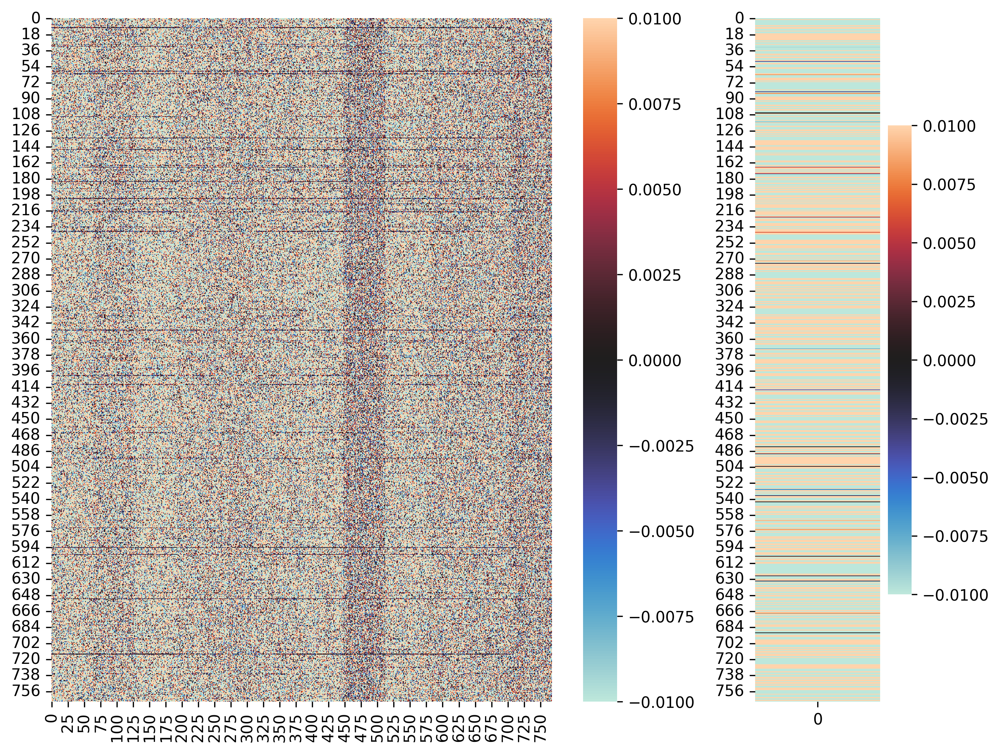

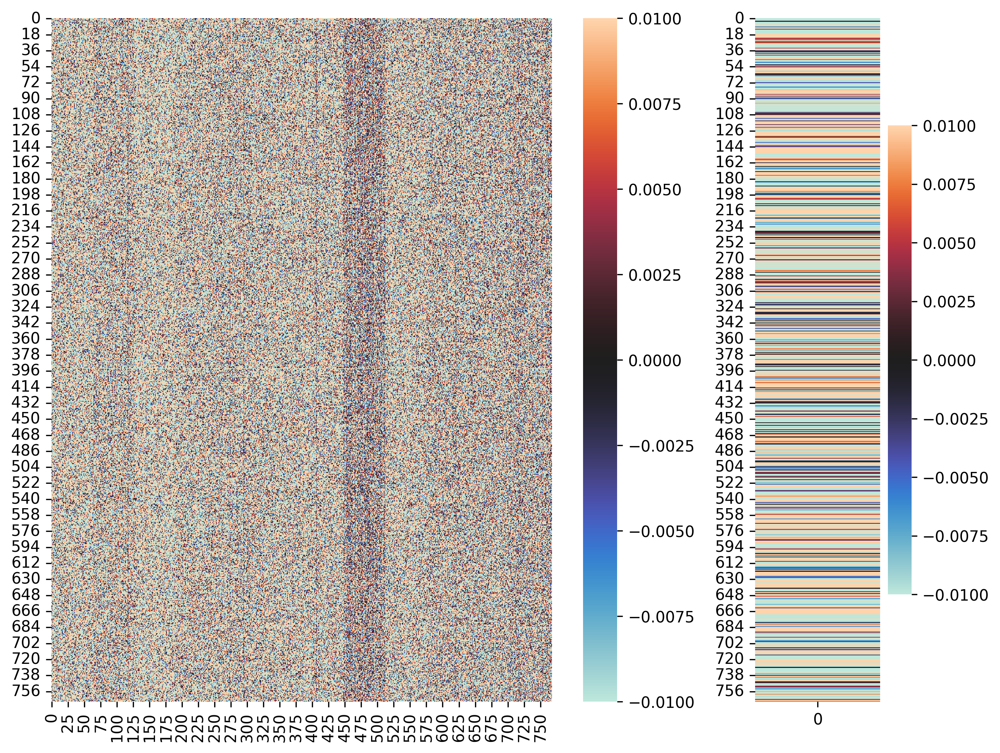

After deleting W_O columns


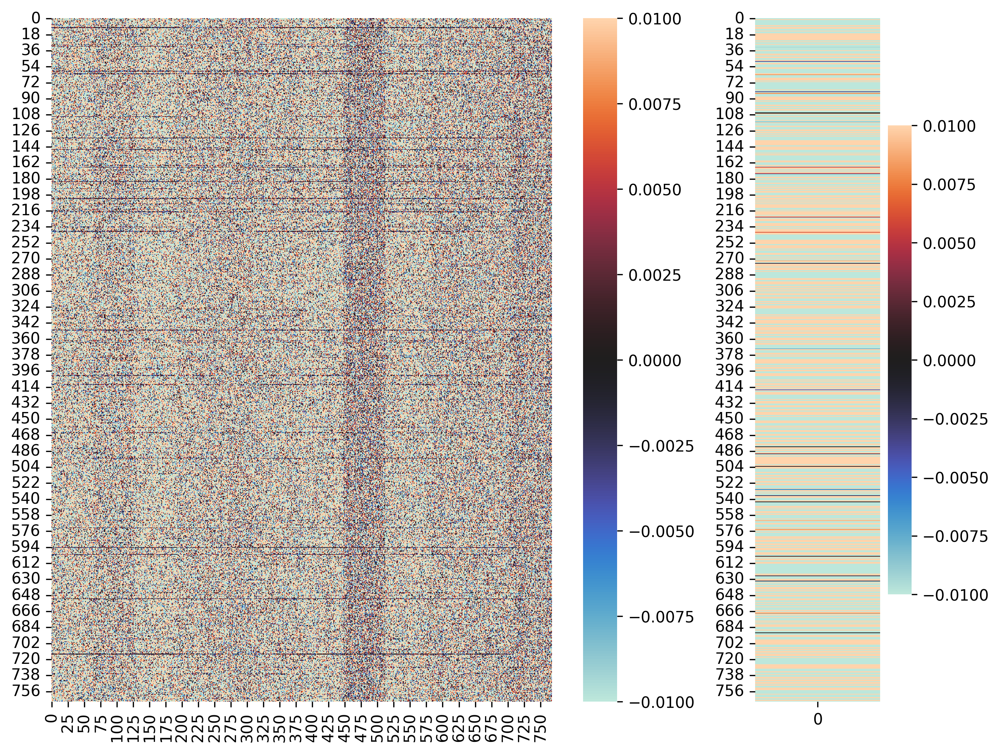

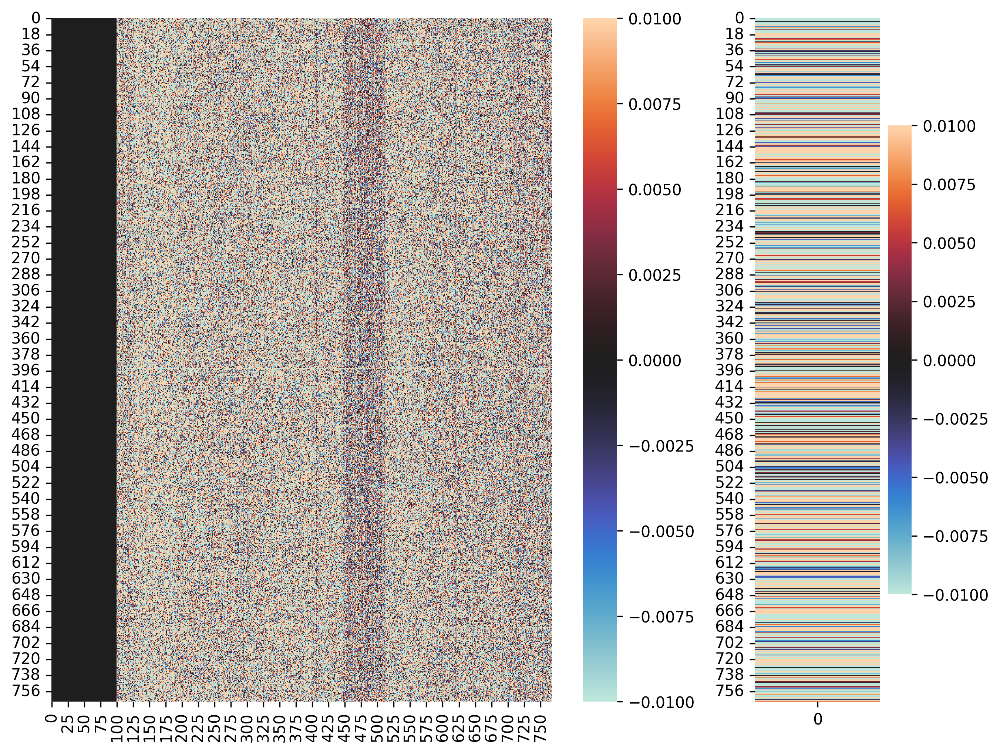

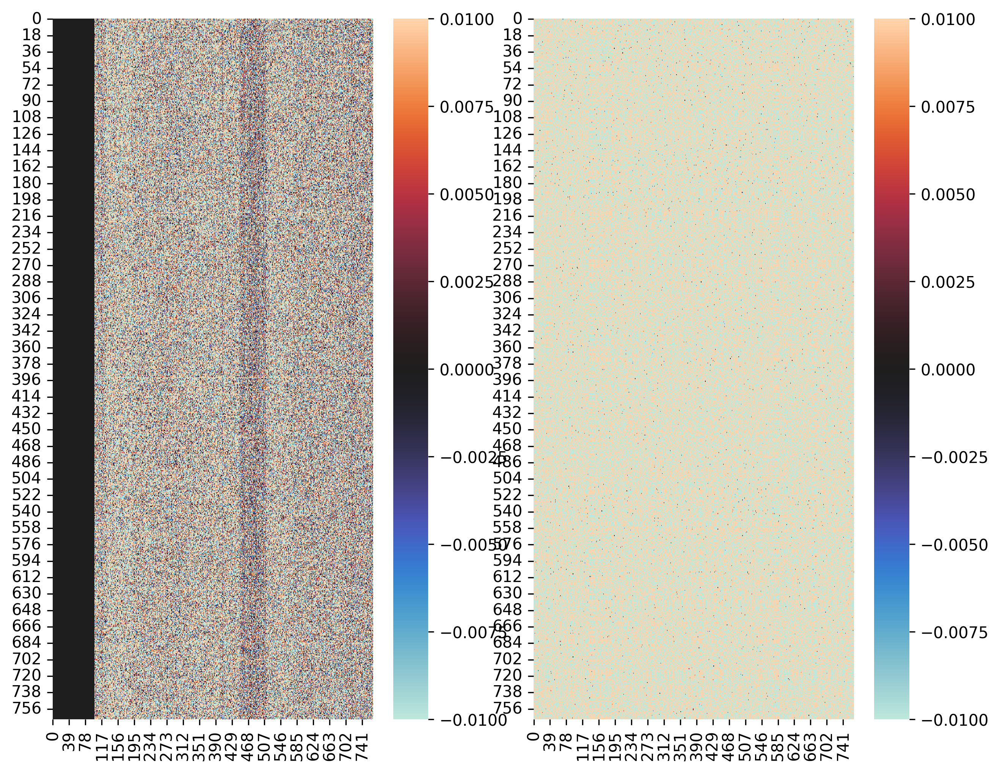

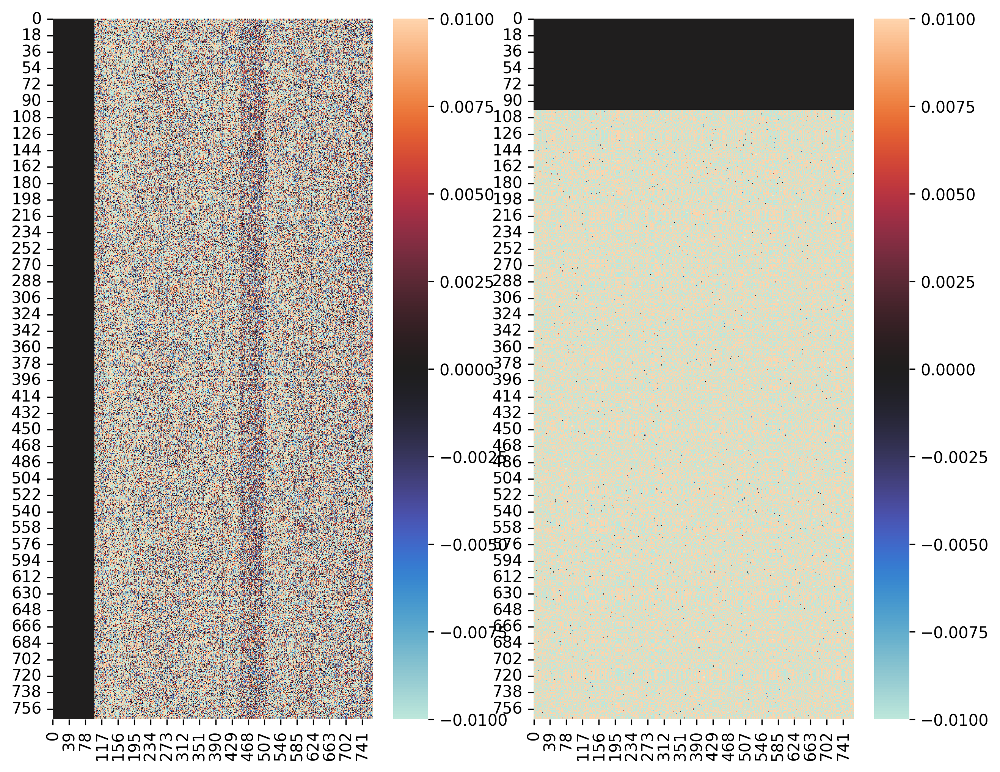

After deleting W_O_inv rows


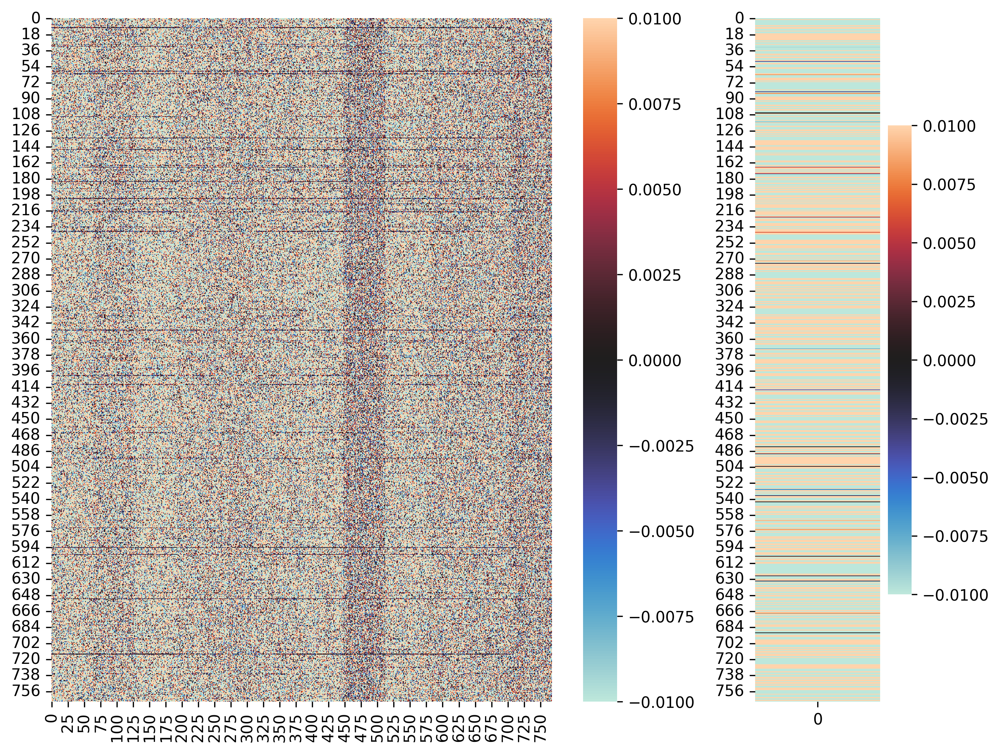

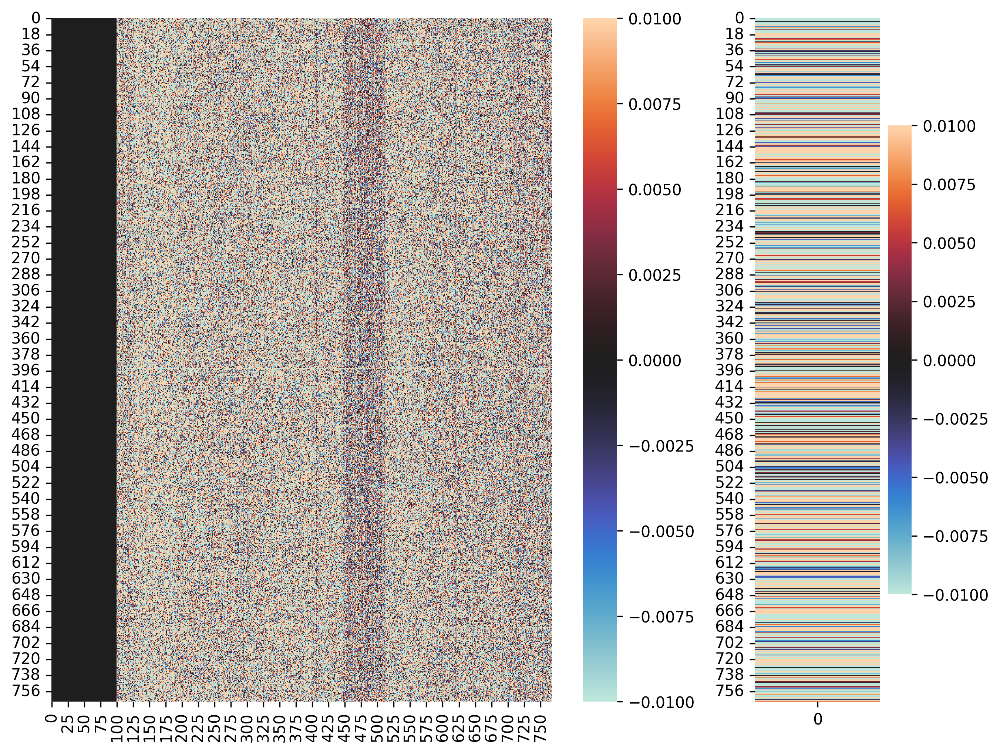

After deleting W_O rows


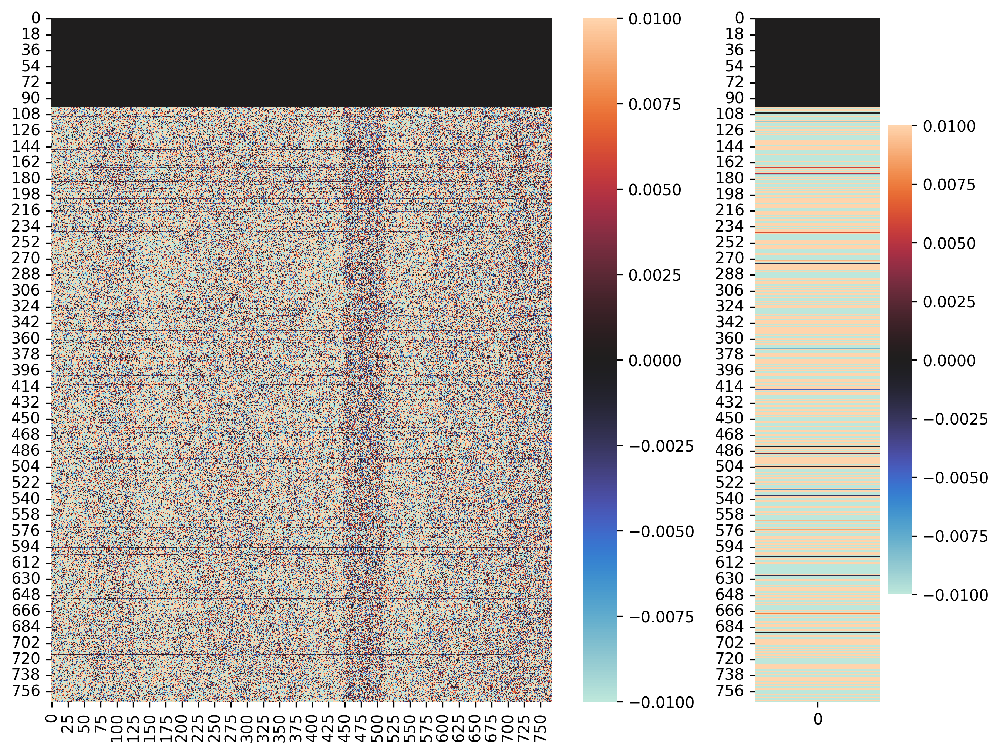

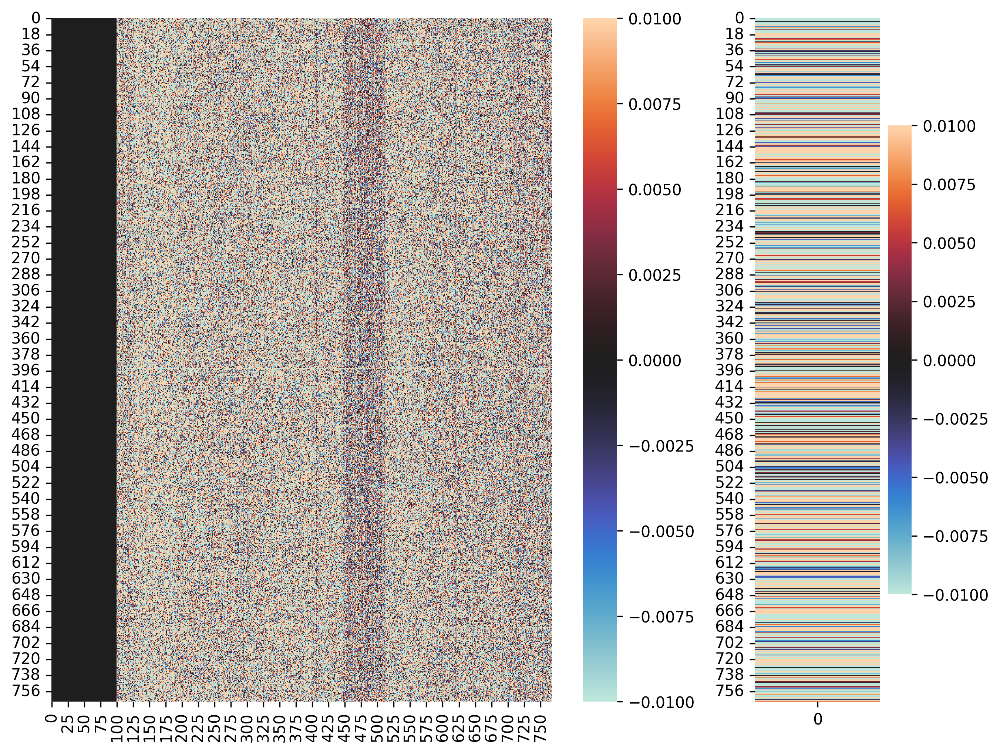

In [ ]:
opt = Model("EleutherAI/pythia-160m", limit=1000)

d = opt.cfg.d_model

# Define plotting function
##########################
def make_plots():
    W_V, b_V = opt.layers[0]["attn.W_V"], opt.layers[0]["attn.b_V"]
    W_O, b_O = opt.layers[0]["attn.W_O"], opt.layers[0]["attn.b_O"]
    d = opt.cfg.d_model

    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,8), dpi=300,
                            gridspec_kw={'width_ratios': [8,2]})
    sns.heatmap(W_V.cpu().reshape(d, d).detach().numpy(), ax=ax[0], center=0, vmin=-0.01, vmax=0.01)
    sns.heatmap(b_V.cpu().reshape(d, 1).detach().numpy(), ax=ax[1], center=0, vmin=-0.01, vmax=0.01)
    plt.show()

    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,8), dpi=300,
                            gridspec_kw={'width_ratios': [8,2]})
    sns.heatmap(W_O.cpu().reshape(d, d).detach().numpy(), ax=ax[0], center=0, vmin=-0.01, vmax=0.01)
    sns.heatmap(b_O.cpu().reshape(d, 1).detach().numpy(), ax=ax[1], center=0, vmin=-0.01, vmax=0.01)
    plt.show()
    
# Run plotting before deletions
###############################
print("before deletions")
make_plots()

# Run deletions
###############
remove_indices = torch.zeros(opt.cfg.d_model)
for i in range(100):
    remove_indices[i] = 1


with torch.no_grad():
    # check tensor sizes are correct
    size = remove_indices.size()
    if size[-1] == opt.cfg.d_head:
        remove_indices = remove_indices.reshape( (*size[:-2], -1) )
        size = remove_indices.size()
    assert remove_indices.size() == torch.Size([opt.cfg.d_model])

    # get the attention that we are changing.
    # We change both (1) the inputs and (2) the outputs of the pre_out
    # layer
    layer = opt.layers[0]

    # Optionally, delete the weights going out of a neuron
    # more of a sanity check.
    if not opt.use_accelerator:
        W_O = layer["attn.W_O"]
        W_O = mlp_delete_columns_raw( W_O, remove_indices )
        layer["attn.W_O"] = W_O

    print("After deleting W_O columns")
    make_plots()

    # Show original W_O_inv
    W_inv = layer["attn.inv_out_proj"].state_dict()["weight"]
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,8), dpi=300)
    sns.heatmap(W_O.cpu().reshape(d, d).detach().numpy(), ax=ax[0], center=0, vmin=-0.01, vmax=0.01)
    sns.heatmap(W_inv.cpu().reshape(d, d).detach().numpy(), ax=ax[1], center=0, vmin=-0.01, vmax=0.01)
    plt.show()
   
    # Additionally, delete inv_out_proj weights (keep track)
    W_O_inv, b_O_inv = layer["attn.W_O_inv"], layer["attn.b_O_inv"]
    W_O_inv, _ = mlp_delete_rows_raw(remove_indices, W_O_inv)
    layer["attn.W_O_inv"], layer["attn.b_O_inv"] = W_O_inv, b_O_inv

    # Show pruned of W_O_inv
    W_inv = layer["attn.inv_out_proj"].state_dict()["weight"]
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,8), dpi=300)
    sns.heatmap(W_O.cpu().reshape(d, d).detach().numpy(), ax=ax[0], center=0, vmin=-0.01, vmax=0.01)
    sns.heatmap(W_inv.cpu().reshape(d, d).detach().numpy(), ax=ax[1], center=0, vmin=-0.01, vmax=0.01)
    plt.show()
    
    print("After deleting W_O_inv rows")
    make_plots()

    # 2. Delete the weights and biases going into neuron (v_proj)
    #  so it never activates in the first place
    W_V, b_V = layer["attn.W_V"], layer["attn.b_V"]
    n_rows = len(W_V)
    for row_index in range(n_rows):
        if remove_indices[row_index]:
            W_V[row_index] = torch.zeros_like(W_V[row_index])
            b_V[row_index] = torch.zeros_like(b_V[row_index])
    layer["attn.W_V"], layer["attn.b_V"] = W_V, b_V
    
    
    print("After deleting W_O rows")
    make_plots()
